# Load the necessary modules

In [25]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load and explore the data sets

Load the Excel file into Pandas data frames

In [26]:
data_file = "../DO_NOT_PUBLISH/MetaboData_pseudoID.xlsx"
metabol = pd.read_excel(data_file, sheet_name="metabs", index_col=0).T
microbio = pd.read_excel(data_file, sheet_name="counts", index_col=0).T
taxon = pd.read_excel(data_file, sheet_name="OTUS", index_col=0)
samples = pd.read_excel(data_file, sheet_name="samples", index_col=0)

## Metabolomics data:

In [3]:
metabol.head()

,glycine,alanine,valine,leucine,isoleucine,serine,threonine,proline,arginine,glutamic,...,tcc,m_bu_p,mehp,x4_hpb,ibp,cibp,apap,apap_g,dcf,hctz
S000178_1,0.357,-0.812,-0.481,-0.238,-0.199,0.505,-0.677,-0.656,0.066,0.234,...,-0.451,0.340,0.337,-0.471,-0.079,-0.139,-0.041,0.025,0.414,-0.437
S000443_1,-0.695,-0.787,-0.859,-0.823,-0.826,-0.846,-0.959,-0.931,-1.085,-0.777,...,-0.451,-0.060,-0.278,-0.764,-0.079,-0.139,-0.132,-0.180,-0.401,-0.437
S000491_1,0.436,0.290,-0.112,-0.158,-0.079,1.056,0.460,0.133,-0.661,-0.358,...,-0.451,1.613,2.228,3.637,-0.079,-0.139,0.084,0.379,0.862,-0.437
S000732_1,-0.184,2.645,2.015,2.111,2.196,1.059,2.439,1.722,1.591,0.486,...,-0.451,-0.477,-0.693,-0.220,-0.079,-0.139,-0.215,-0.243,0.852,-0.437
S000732_2,0.160,0.766,0.429,0.311,0.450,-0.197,2.420,-0.080,0.159,0.138,...,-0.451,-0.842,-0.565,-0.228,-0.079,-0.139,0.623,2.060,1.023,-0.437


In [4]:
# Check if we have any NULL or NA values
print("NA values:", metabol.isna().values.any())
print("NULL values:", metabol.isnull().values.any())

NA values: False
NULL values: False


In [5]:
# Min-max normalization
metabol.iloc[:,:] = MinMaxScaler().fit_transform(metabol)
metabol.head()

,glycine,alanine,valine,leucine,isoleucine,serine,threonine,proline,arginine,glutamic,...,tcc,m_bu_p,mehp,x4_hpb,ibp,cibp,apap,apap_g,dcf,hctz
S000178_1,0.203059,0.111499,0.191536,0.250043,0.257227,0.298541,0.066532,0.136444,0.188422,0.174716,...,0.0,0.271801,0.266637,0.161973,0.0,0.0,0.018271,0.028760,0.296658,0.0
S000443_1,0.073279,0.115869,0.132288,0.149303,0.148693,0.084232,0.022798,0.092352,0.025114,0.074864,...,0.0,0.221467,0.197153,0.129863,0.0,0.0,0.009566,0.010220,0.199715,0.0
S000491_1,0.212805,0.304089,0.249373,0.263820,0.277999,0.385945,0.242866,0.262947,0.085272,0.116247,...,0.0,0.431987,0.480285,0.612164,0.0,0.0,0.030228,0.060776,0.349946,0.0
S000732_1,0.136319,0.715659,0.582759,0.654555,0.671802,0.386421,0.549783,0.517717,0.404796,0.199605,...,0.0,0.168995,0.150266,0.189479,0.0,0.0,0.001626,0.004522,0.348757,0.0
S000732_2,0.178756,0.387277,0.334169,0.344584,0.369569,0.187183,0.546836,0.228796,0.201617,0.165235,...,0.0,0.123065,0.164727,0.188603,0.0,0.0,0.081787,0.212806,0.369097,0.0


In [7]:
print("Number of observations:", metabol.shape[0])
print("Number of variables:", metabol.shape[1])
print("Number of data points:", np.multiply(*metabol.shape))

Number of observations: 1023
Number of variables: 411
Number of data points: 420453


Show the data distribution with some plots

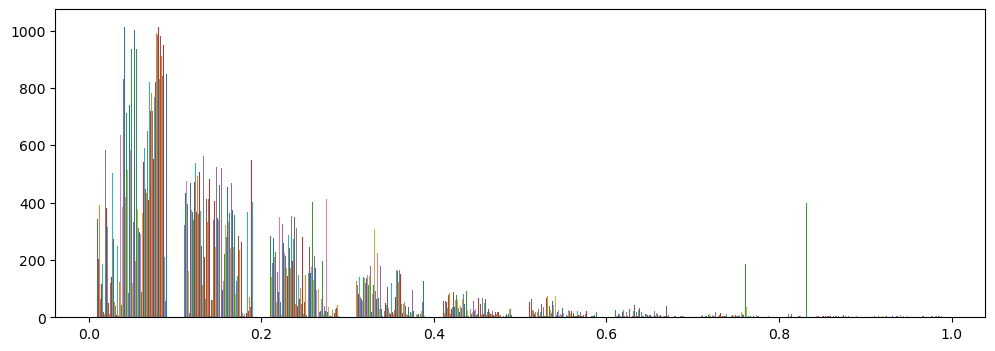

In [8]:
plt.figure(figsize=(12,4))
plt.hist(metabol)
plt.show()

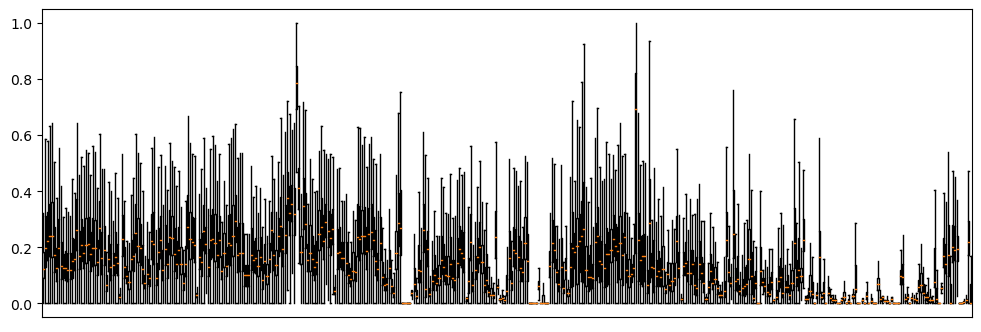

In [9]:
plt.figure(figsize=(12,4))
plt.boxplot(metabol, showfliers=False)
plt.xticks([],[])
plt.show()

## Micriobiome data:

In [10]:
microbio.head()

,k_Archaea,k_Bacteria,p_WS4,p_WS2,p_Verrucomicrobia,p_Thaumarchaeota,p_Tenericutes,p_Synergistetes,p_Spirochaetes,p_RsaHF231,...,g_uncultured_Fimbriimonas_sp.,g_uncultured_gamma_proteobacterium,g_uncultured_Porphyromonadaceae_bacterium,g_uncultured_Thermoanaerobacterales_bacterium,g_UTCFX1,g_Veillonella,g_Victivallis,g_WCHB1-32,g_Wolbachia,g_Z20
S000178_1,0,44819,0,0,0,0,25,0,0,0,...,0,0,0,0,0,0,0,0,0,0
S000443_1,0,23881,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
S000491_1,0,50188,0,0,5,0,192,0,0,0,...,0,0,135,0,0,0,0,0,0,0
S000732_1,0,45267,0,0,15,0,54,0,52,0,...,0,0,107,25,0,0,0,0,0,0
S000732_2,0,41718,0,0,31,0,49,0,11,0,...,0,0,0,16,0,1,0,0,0,0


In [11]:
# Check if we have any NULL or NA values
print("NA values:", microbio.isna().values.any())
print("NULL values:", microbio.isnull().values.any())

NA values: False
NULL values: False


In [12]:
# Remove variables with more than 80% of zeros
index = np.sum(microbio == 0, axis=0) < 0.8*microbio.shape[0]
microbio = microbio.loc[:,index]

In [13]:
# Min-max normalization
microbio.iloc[:,:] = MinMaxScaler().fit_transform(microbio)
microbio.head()

,k_Archaea,k_Bacteria,p_Verrucomicrobia,p_Tenericutes,p_Proteobacteria,p_Firmicutes,p_Euryarchaeota,p_Cyanobacteria,p_Bacteroidetes,p_Actinobacteria,...,g_Ruminococcaceae_UCG-014,g_Ruminococcus_1,g_Ruminococcus_2,g_Senegalimassilia,g_Slackia,g_Subdoligranulum,g_Sutterella,g_Tyzzerella,g_UBA1819,g_uncultured_Thermoanaerobacterales_bacterium
S000178_1,0.0,0.391580,0.000000,0.003000,0.012254,0.433434,0.0,0.003976,0.180153,0.498416,...,0.043271,0.135455,0.294620,0.445705,0.041899,0.146540,0.000000,0.000000,0.026699,0.000000
S000443_1,0.0,0.168189,0.000000,0.000000,0.001497,0.222119,0.0,0.000823,0.057105,0.311842,...,0.005134,0.023933,0.012383,0.012966,0.000000,0.347160,0.000000,0.007874,0.026699,0.000000
S000491_1,0.0,0.448863,0.007974,0.023044,0.046964,0.407962,0.0,0.169478,0.333541,0.164483,...,0.205354,0.061189,0.021492,0.265802,0.170391,0.245978,0.333333,0.000000,0.029126,0.000000
S000732_1,0.0,0.396360,0.023923,0.006481,0.026615,0.413446,0.0,0.005896,0.275262,0.141022,...,0.174551,0.092771,0.307572,0.246353,0.058659,0.136073,0.142857,0.060367,0.060680,0.096154
S000732_2,0.0,0.358495,0.049442,0.005881,0.016801,0.349804,0.0,0.005210,0.289667,0.085196,...,0.205354,0.080928,0.069314,0.192869,0.030726,0.073076,0.000000,0.018373,0.014563,0.061538


In [14]:
print("Number of observations:", microbio.shape[0])
print("Number of variables:", microbio.shape[1])
print("Number of data points:", np.multiply(*microbio.shape))

Number of observations: 1023
Number of variables: 172
Number of data points: 175956


Show the data distribution with some plots

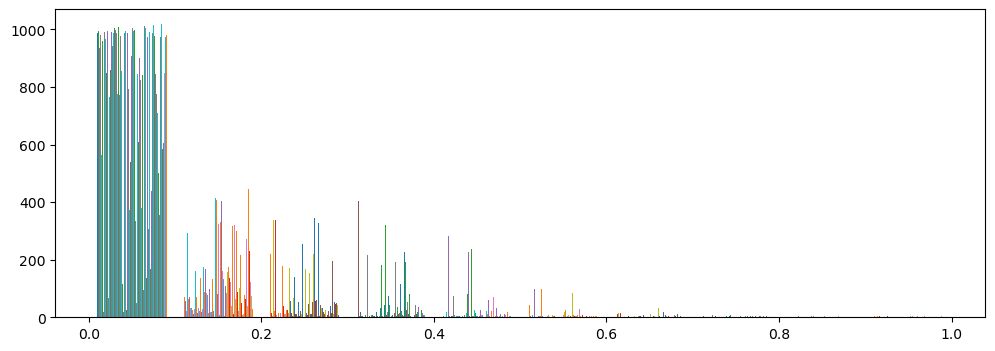

In [15]:
plt.figure(figsize=(12,4))
plt.hist(microbio)
plt.show()

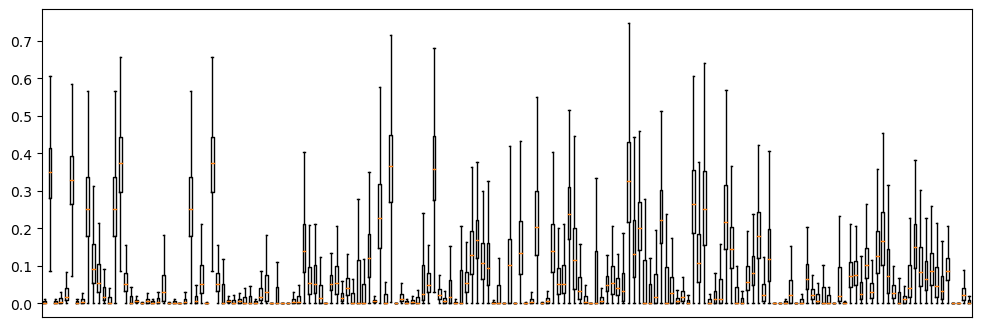

In [16]:
plt.figure(figsize=(12,4))
plt.boxplot(microbio, showfliers=False)
plt.xticks([],[])
plt.show()

## Samples health related data:

In [80]:
samples.head()

,X.SampleID,KKHNGID,time_origin,gender,pred_risk,CVrisk3,AGE,SCBIA1,SCANT2,SCBIA4,TG,HDL,LDL,CHO,HBA1CPC,SCBP1,SCBP2,HSCRP,CR
S000178_1,S000178_1,20161,baseline,1,0.020379,Hig,51,22.52,90.0,10.15,1.13,1.68,4.94,6.87,5.1,125,90,0.71,77.0
S000443_1,S000443_1,3557,baseline,2,0.000580,Low,41,23.06,96.8,33.33,1.30,1.68,2.78,4.29,5.5,113,78,0.32,63.0
S000491_1,S000491_1,1783,baseline,2,0.001671,Med,47,22.15,92.3,30.20,0.90,1.46,2.80,4.69,5.3,117,82,0.78,65.0
S000732_1,S000732_1,104735,baseline,2,0.000308,Low,38,22.90,87.6,30.42,1.38,1.94,1.56,3.54,5.2,109,83,2.86,70.0
S000732_2,S000732_2,104735,six,2,0.000398,Low,39,23.34,102.5,31.41,1.10,1.86,1.65,3.82,4.9,117,83,2.13,78.0


In [81]:
# Check if we have any NULL or NA values
print("NA values:", samples.isna().values.any())
print("NULL values:", samples.isnull().values.any())

NA values: True
NULL values: True


There are some missing values.
I found that 4 observations have a missing valure for the variable *CVrisk3*.
I'll drop theese observations.

In [82]:
drop_index = samples[samples['CVrisk3']==-1].index
samples.drop(drop_index, inplace=True)

This data set contains some health indicators measured on the sampled individuals.
The measures were repeated three times at different moments (base line, six months, twelve monts).

We have three categorical variables:
- *time_origin*: time when the indicators where measured
- *gender*: gender of the individual
- *CVrisk3*: risk of cardiovascular disease.

Also, we have some numerical variables: the age of the individual and 12 health indicators.

The following variables seem that can be of intereset for this study:
- *time_origin*: the health indicators where measured on the same individuals in three different times. We should not expect to observe big differences on the same individual.
- *gender*: intuitively, it makes sense that at least some of the health indicators will distribute differently on both genders.
- *CVrisk3*: since this variable should be the result of a calculation involving the other health indicators, we should expect to observe a clear relation.
- *Age*: intuitively, we should expect to see a relation between the age and the health indicators, observing better values for younger individuals.

I'll codify the categorical variables and do a brief exploration of the data set.

In [32]:
# Code gender as 0, 1
samples['gender'] = samples['gender'] -1

# Code CVrisk3 as 0, 1, 2
samples['CVrisk3'] = pd.Categorical(samples['CVrisk3'], categories=('Low','Med','Hig')).codes

# Convert time_origin to categorical type
samples['time_origin'] = pd.Categorical(samples['time_origin'], categories=('baseline','six','twelve'))

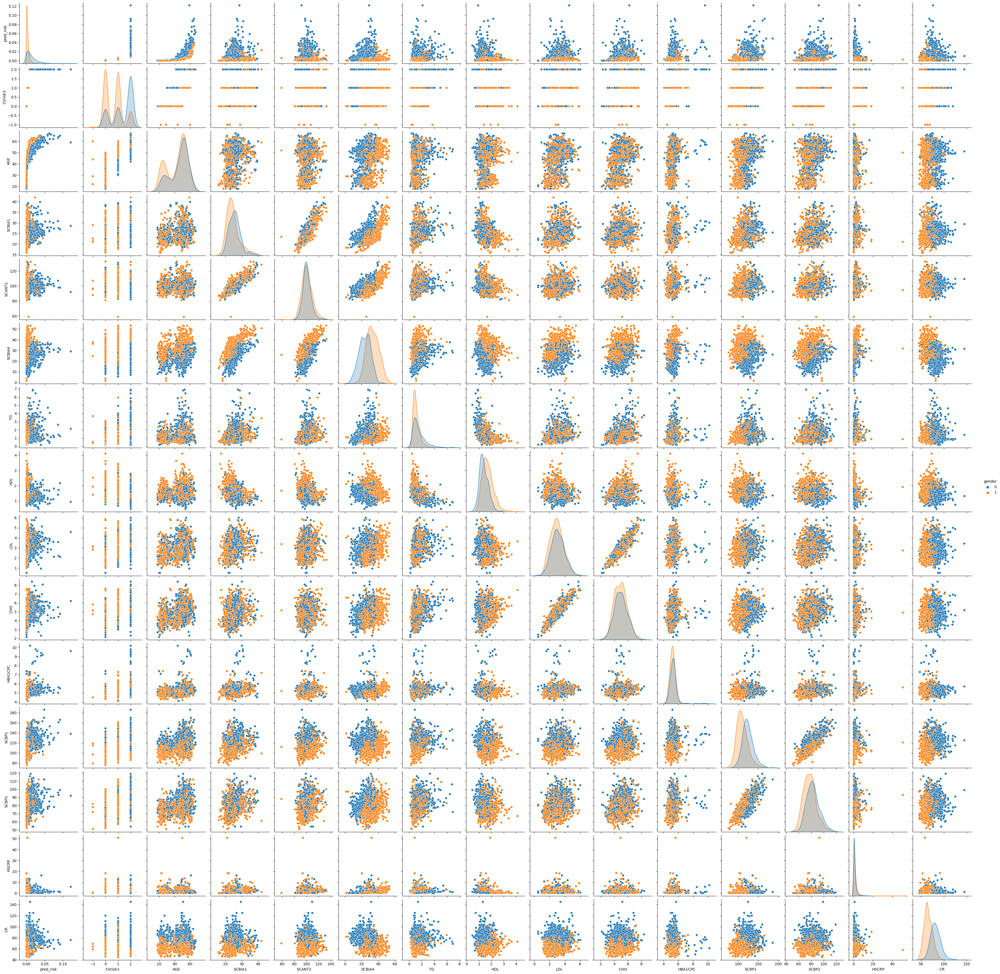

In [21]:
sns.pairplot(samples.iloc[:,3:], hue='gender')
plt.show()

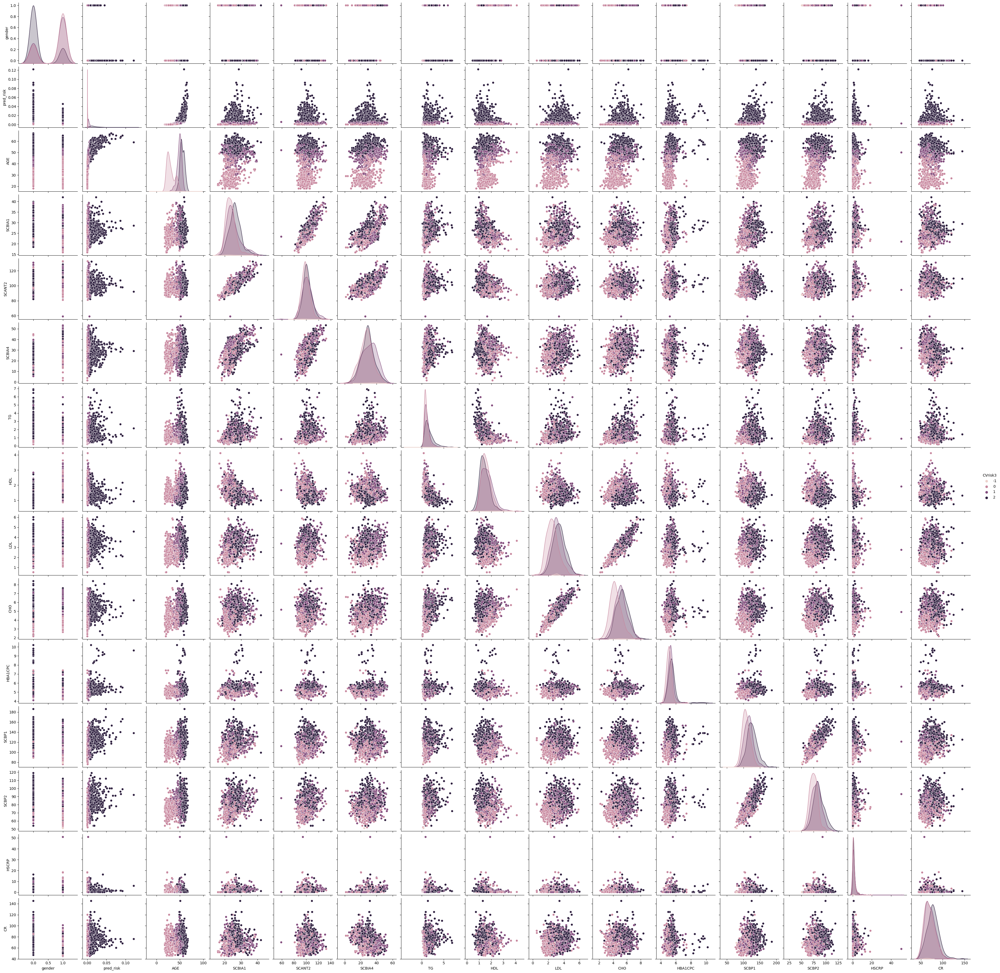

In [22]:
sns.pairplot(samples.iloc[:,3:], hue='CVrisk3')
plt.show()

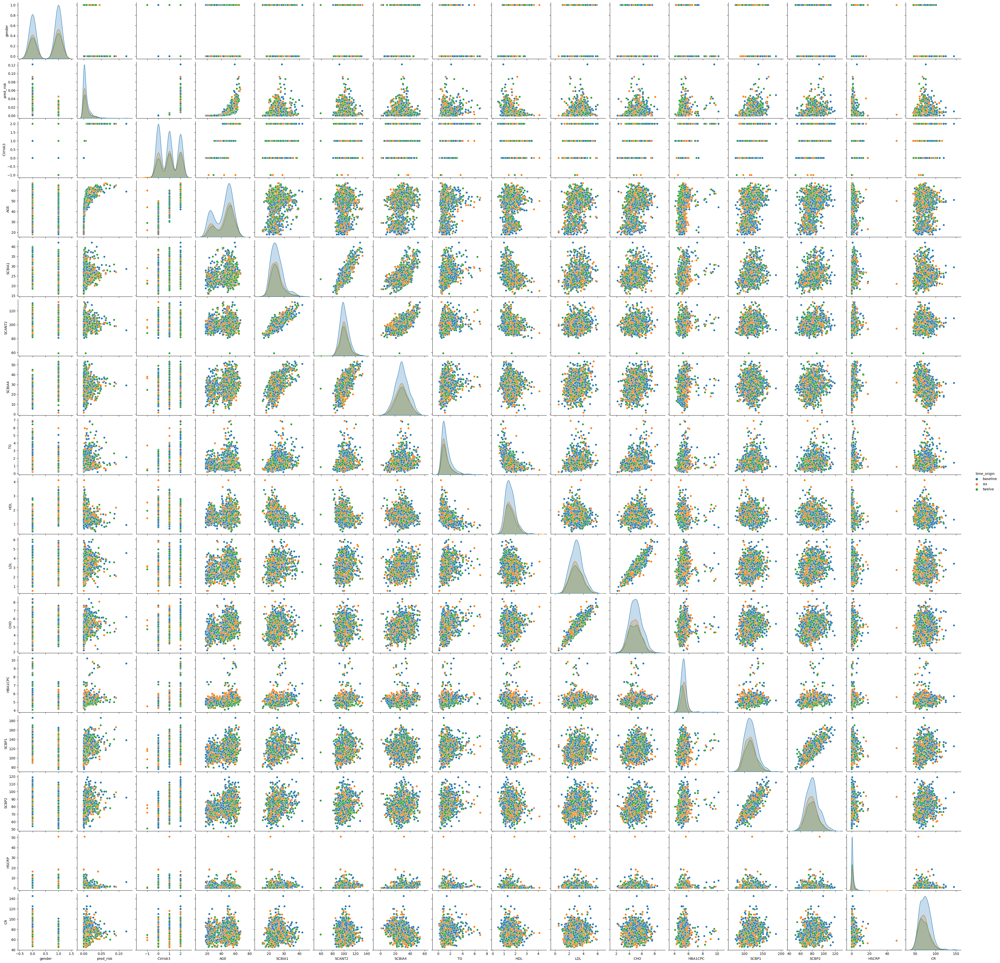

In [23]:
sns.pairplot(samples.iloc[:,2:], hue='time_origin')
plt.show()

From this plots we can infer some characteristics of the data:

- The majority of the high CV risk are individuals of gender 1.
- Almost all the variables show a differential distribution depending on the categories of *gender*.
- The same happens for the categories of *CVrisk3*.
- In particular, the variable age clearly shows a different distribution for CVrisk3 = low with respect to CVrisk3 = med or high.
- The categories of 'time_origin' do not seem to inform any of the distributions, as should be expected.
- Some of the numerical variables show clear correlations, which makes sense since we should expected them to be related.
  - SCBIA1, SCANT2 and SCBIA4
  - HDL and LDL
  - SCBP1 and SCBP2

The correlations are more easily shown with a heatmap:

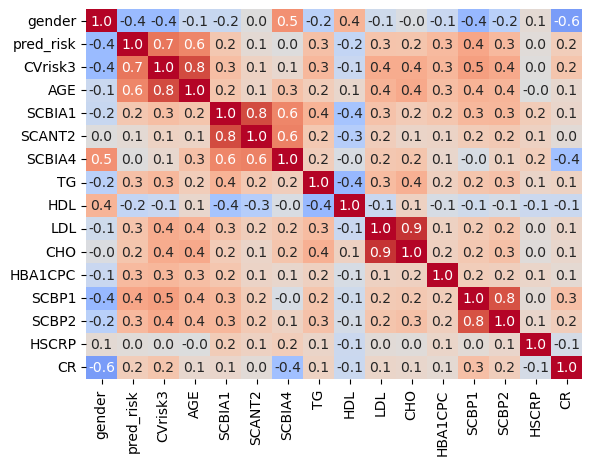

In [24]:
corr = samples.iloc[:,3:].corr()
sns.heatmap(corr, annot=True, fmt=".1f", cmap="coolwarm", vmin=-1, vmax=1, cbar=False)
plt.show()

My decision is to use tha variables *gender* or *CVrisk3*
to compare the clusters resulting from the different methods.
My reasoning is that
if I'm able to find clusters on the metabolomics data
that somewhat correlate to any of the health indicators,
I should expect that this clusters will show some overlap
with the *gender* or *CVrisk3* categories.
I discarded the *age* variable, since it shows a clear correlation with *CVrisk3*.

Also, I expect that the obseravtions from the same individuals (on different times)
should be assigned to the same cluster.

Finally,
I want to check if the group sizes for both variables
are balanced:

In [83]:
samples['gender'].value_counts()

2    726
1    598
Name: gender, dtype: int64

In [84]:
samples['CVrisk3'].value_counts()

Low    444
Med    443
Hig    433
Name: CVrisk3, dtype: int64

The groups are fairly well balanced